# Semi-discrete Optimal Transport

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/gpeyre/ot4ml/blob/main/python/4-semidiscrete.ipynb)

This numerical tour studies **semi-discrete optimal transport**, where one of the two measures is discrete and the other is continuous.

The foundational works for this approach include:
- [Oliker89], [Aurenhammer98]

More recent references and fast implementations can be found in:
- [Mérigot11], [Lévy15]

⚠️ **Note**: This tour is not intended to present efficient algorithms, but rather to convey the **core ideas** behind semi-discrete OT, including:
- The **$c$-transform**
- **Laguerre cells**
- The **connection to optimal quantization**

In the **Euclidean case**, efficient algorithms for computing Laguerre cells exist, leveraging computational geometry techniques—especially algorithms for computing convex hulls (see [Aurenhammer87]).

In [1]:
using Plots

## Dual OT and c-Transforms

The **primal Kantorovich optimal transport problem** is given by:
$$
W_c(\alpha, \beta) = \min_{\pi} \left\{ \int_{\mathcal{X} \times \mathcal{Y}} c(x, y) \, \mathrm{d}\pi(x, y) \;\middle|\; \pi_1 = \alpha, \; \pi_2 = \beta \right\}.
$$

Its **dual formulation** reads:
$$
W_c(\alpha, \beta) = \max_{f, g} \left\{ \int_{\mathcal{X}} f \, \mathrm{d}\alpha + \int_{\mathcal{Y}} g \, \mathrm{d}\beta \;\middle|\; f(x) + g(y) \leq c(x, y) \right\}.
$$

We consider the **semi-discrete case**, where $\alpha = \sum_i a_i \delta_{x_i}$ is a discrete measure. In this case:
- The function $f(x)$ becomes a vector $(f_i)_{i=1}^n \in \mathbb{R}^n$.
- The function $g(y)$ is replaced by the **$c$-transform** of $f$:
$$
f^c(y) := \min_i \left\{ c(x_i, y) - f_i \right\}.
$$

The dual objective becomes:
$$
W_c(\alpha, \beta) = \max_{f \in \mathbb{R}^n} \mathcal{E}(f) := \sum_i f_i a_i + \int f^c(y) \, \mathrm{d}\beta(y).
$$

## Semi-Discrete via Gradient Ascent

We now implement a **gradient ascent scheme** to maximize $\mathcal{E}(f)$. This is done by introducing a partition of the domain $\mathcal{Y}$ into **Laguerre cells**:
$$
\mathcal{Y} = \bigcup_i L_i(f), \quad \text{where} \quad
L_i(f) := \left\{ y \in \mathcal{Y} \;\middle|\; \forall j, \; c(x_i, y) - f_i \leq c(x_j, y) - f_j \right\}.
$$

- When $f = 0$, this reduces to the standard **Voronoi partition**.
- On each Laguerre cell $L_i(f)$, we have:
$$
f^c(y) = c(x_i, y) - f_i,
$$
which means $f^c$ is **piecewise smooth** across the partition.

To evaluate the objective $\mathcal{E}(f)$ numerically, we approximate the continuous measure $\beta$ using **a grid** over $\mathcal{Y}$ and use this grid to integrate $f^c(y)$ efficiently.

In [2]:
p = 300  # size of the image for sampling, m=p*p
t = LinRange(0, 1, p)
U = repeat(t, 1, length(t))
V = repeat(t', length(t), 1)
Y = vcat(reshape(U, 1, :), reshape(V, 1, :));

We define the **first measure** as a finite sum of Dirac masses:
$$
\alpha = \sum_{i=1}^n a_i \, \delta_{x_i},
$$
where:
- $x_i \in \mathbb{R}^d$ are the support points,
- $a_i > 0$ are the associated weights (often normalized so that $\sum_i a_i = 1$),
- $\delta_{x_i}$ denotes the Dirac mass at location $x_i$.

This measure represents a discrete distribution supported on a finite set of points.

In [3]:
n = 30
X = .5 .+ .5im .+ exp(1im*pi/4) .* 1 .*
    (.1 * (rand(1, n) .- 0.5) .+ 1im*(rand(1, n) .- 0.5))
X = vcat(real(X), imag(X))
a = ones(n)/n;

We define the **second measure** $\beta$ as a potentially **continuous distribution**, for instance a **mixture of Gaussians**.

To make the semi-discrete formulation tractable numerically, we discretize $\beta$ over a fine grid, resulting in:
$$
\beta \approx \sum_{j=1}^m b_j \, \delta_{y_j},
$$
where:
- $y_j \in \mathbb{R}^d$ are points on a regular or adaptive grid,
- $b_j > 0$ are the weights approximating the density at each $y_j$ (typically normalized so that $\sum_j b_j = 1$),
- $\delta_{y_j}$ is the Dirac mass at $y_j$.

This discretization allows us to compute integrals over $\beta$ via weighted sums, enabling the evaluation of functionals like $f^c(y)$ and its gradients.

In [4]:
Gauss(mx, my, s) = exp.(-((U .- mx).^2 + (V .- my).^2) ./ (2*s^2))

Mx = [.6, .4]   # means
My = [.9, .1]
S =  [.07, .09] # variance
W =  [.5, .5]   # weights
b = W' * Gauss.(Mx, My, S)
b = b/sum(b);

Display the two measures.

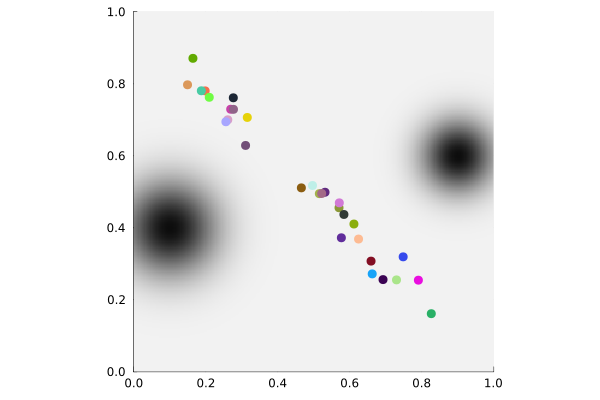

In [5]:
Col = [RGB(rand(3)...) for _ in 1:n]
heatmap(t, t, -b, aspect_ratio=:equal, colorbar=false, xlim=(0,1), ylim=(0,1), cmap=:grays)
scatter!(X[2, :], X[1, :], markersize=5, markerstrokewidth=0, color=Col, label=nothing)

Initial potentials.

In [6]:
f = zeros(n);

compute Laguerre cells and c-transform

In [7]:
distmat(x, y) = sum(abs2, x, dims=1)' .+ sum(abs2, y, dims=1) .- 2 .* x' * y

D = distmat(Y, X) .- f'
fC = minimum(D, dims=2)
I = reshape(getindex.(argmin(D, dims=2), 2), (p, p));

The **dual value** of the optimal transport problem in the semi-discrete setting is given by:
$$
\langle f, a \rangle + \langle f^c, \beta \rangle,
$$
where:
- $f \in \mathbb{R}^n$ is the dual potential associated with the discrete measure $\alpha = \sum_i a_i \delta_{x_i}$,
- $f^c$ is the **$c$-transform** of $f$ evaluated at the grid points $y_j$,
- $\beta = \sum_j b_j \delta_{y_j}$ is the discretized second measure.

Explicitly, this becomes:
$$
\sum_{i=1}^n f_i a_i + \sum_{j=1}^m f^c(y_j) b_j.
$$

This dual value approximates the OT cost when the optimal potentials are used.

In [8]:
OT = sum(f .* a) + sum(fC .* vec(b))

0.10042043263739203

Display the Laguerre call partition (here this is equal to the Vornoi
diagram since $f=0$).

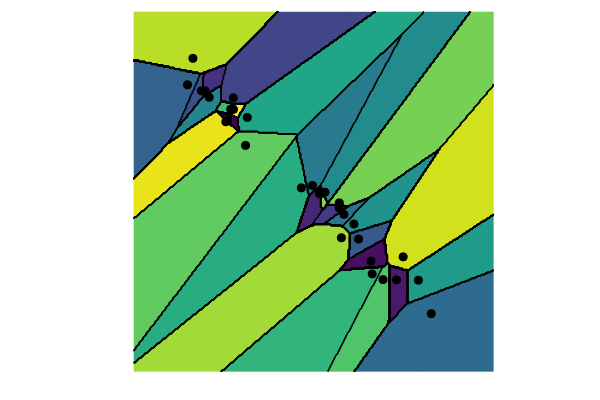

In [9]:
heatmap(t, t, I, xlim=(0,1), ylim=(0,1), aspect_ratio=:equal, colorbar=false, c=:viridis)
scatter!(X[2, :], X[1, :], markersize=5, color=:black, label=nothing, axis=false)
contour!(t, t, I, levels=range(0.5, n-0.5, n), color=:black)

When the measure $\beta$ has a **density with respect to the Lebesgue measure**, the dual objective $\mathcal{E}(f)$ becomes a **smooth function** of $f$.

Its gradient is given by:
$$
\nabla \mathcal{E}(f)_i = a_i - \int_{L_i(f)} \mathrm{d}\beta(x),
$$
where $L_i(f)$ is the **Laguerre cell** associated with $x_i$:
$$
L_i(f) := \left\{ y \in \mathcal{Y} \;\middle|\; \forall j, \; c(x_i, y) - f_i \leq c(x_j, y) - f_j \right\}.
$$

This expression has a natural interpretation:
- $a_i$ is the desired mass assigned to site $x_i$,
- $\int_{L_i(f)} \mathrm{d}\beta(x)$ is the **amount of mass actually captured** by $x_i$.

Thus, the gradient encodes the **mass imbalance** between the discrete weights $a_i$ and the volume of the corresponding Laguerre cells under the continuous measure $\beta$.

In practice, this means that to compute the gradient, one sums the measure (or area) of each Laguerre cell:
- If $\beta$ is uniform over a grid, this reduces to counting the number of grid points inside each $L_i(f)$, weighted by their grid mass $b_j$.

We now implement a **gradient ascent** algorithm to maximize the dual OT objective:
$$
f \leftarrow f + \tau \, \nabla \mathcal{E}(f),
$$
where:
- $\tau > 0$ is the **step size**,
- $\nabla \mathcal{E}(f)_i = a_i - \int_{L_i(f)} \mathrm{d}\beta(x)$ is the gradient (as defined previously),
- $L_i(f)$ are the **Laguerre cells** associated with the current potential $f$.


We explore the effect of different values of $\tau$ on:
- The **convergence behavior** of the optimization,
- The **stability** of the updates,
- The **quality** of the resulting Laguerre partition.

At each iteration, display:
- The **value of the dual objective** $\mathcal{E}(f) = \langle f, a \rangle + \langle f^c, \beta \rangle$ to monitor convergence,
- The **Laguerre cells** $L_i(f)$ to visualize how the domain is partitioned over time.

This allows you to understand how mass is redistributed and how the geometry of the optimal transport adapts to align the discrete and continuous measures.

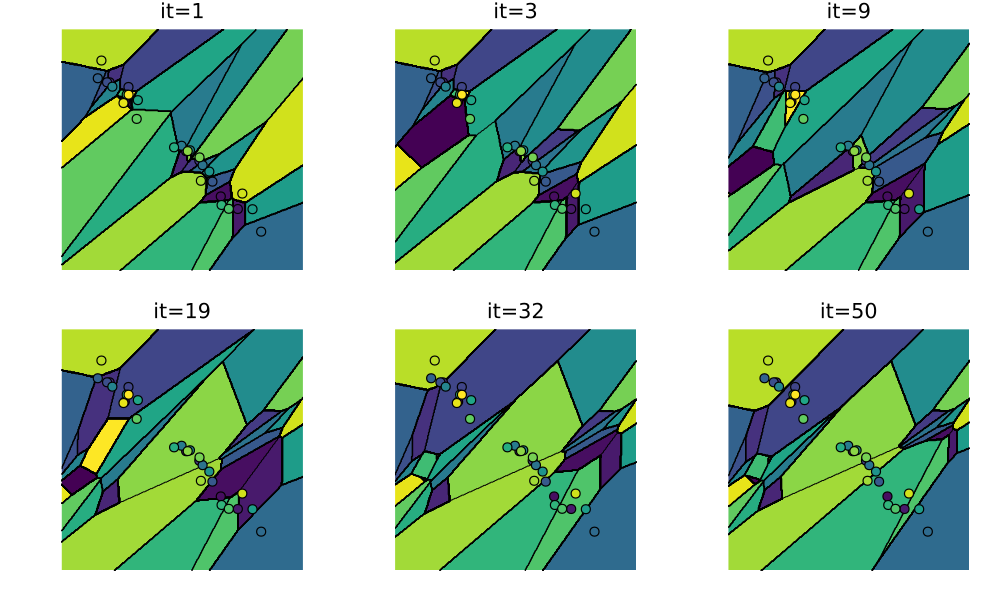

In [10]:
tau = .02  # step size
niter = 200  # iteration for the ascent
q = 6  # number of displays
ndisp = round.(Int, 1 .+ (niter/4-1) .* LinRange(0, 1, q).^2)
kdisp = 1
f = zeros(n)
E = zeros(niter)

plt = plot(
    size=(1000, 600),
    layout=(2,div(q,2)),
    aspect_ratio=:equal,
    border=:none,
    xlims=(0,1),
    ylims=(0,1)
)

# assign color to source points
cmap = :viridis
x_color = get(cgrad(cmap), LinRange(0, 1, n))

for it in 1:niter
    # compute Laguerre cells and c-transform
    D = distmat(Y, X) .- f'
    fC = minimum(D, dims=2)
    I = reshape(getindex.(argmin(D, dims=2), 2), (p, p))
    E[it] = sum(f .* a) + sum(fC .* vec(b))

    # display
    if (kdisp <= length(ndisp)) && (ndisp[kdisp] == it)
        heatmap!(plt[kdisp], t, t, I, aspect_ratio=:equal, colorbar=false, c=cmap)
        contour!(plt[kdisp], t, t, I, levels=range(0.5, n-0.5, n), color=:black)
        scatter!(plt[kdisp], X[2, :], X[1, :], markersize=5, color=x_color, label=nothing, axis=false)
        plot!(plt[kdisp], title="it=$it")
        kdisp = kdisp + 1
    end

    # gradient
    R = [sum(b[I .== i]) for i in 1:n]
    nablaE = a .- R
    f = f .+ tau .* nablaE
end

display(plt)

Display the evolution of the estimated OT distance.

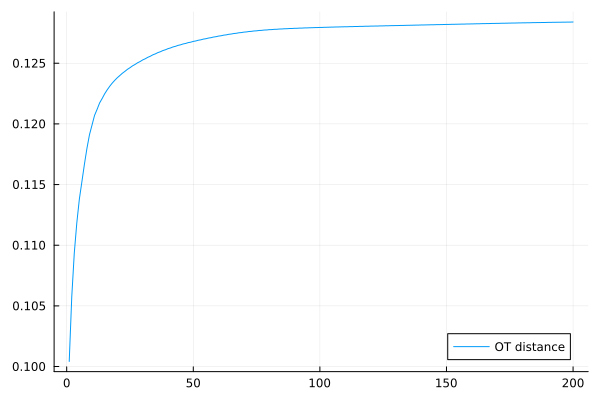

In [11]:
plot(E, label="OT distance")

Stochastic Optimization
-----------------------

The dual objective function $\mathcal{E}(f)$ can be written as an **expectation** over a random variable $Y \sim \beta$:
$$
\mathcal{E}(f) = \mathbb{E}\big[ E(f, Y) \big], \quad \text{where} \quad E(f, y) = \langle f, a \rangle + f^c(y).
$$



As proposed in [Genevay16], one can apply **stochastic gradient ascent** to optimize $\mathcal{E}(f)$.

At iteration $\ell$, the update rule becomes:
$$
f \leftarrow f + \tau_\ell \nabla E(f, y_\ell),
$$
where:
- $y_\ell \sim \beta$ is a random sample drawn from the continuous measure,
- $\tau_\ell$ is the step size at iteration $\ell$, typically chosen to decay as $\tau_\ell \sim 1/\ell$,
- $\nabla E(f, y_\ell)$ is a stochastic estimate of the full gradient.


The gradient of the instantaneous functional $E(f, y)$ with respect to $f$ is given by:
$$
\nabla E(f, y)_i = a_i - \mathbf{1}_{L_i(f)}(y),
$$
where $\mathbf{1}_{L_i(f)}(y)$ is the **indicator function** that equals 1 if $y \in L_i(f)$ and 0 otherwise.

This stochastic approach allows us to scale semi-discrete optimal transport to high-resolution grids without summing over all $y_j$ at each step.


Initialize the algorithm.

In [12]:
f = zeros(n);

Draw the sample.

In [13]:
k = rand() < W[2] ? 2 : 1 # select one of the two Gaussian
y = S .* randn(2) .+ [Mx[k], My[k]];

Compute the randomized gradient: detect Laguerre cell where $y$ is.

In [14]:
R = sum(y.^2) .+ sum(X.^2, dims=1) .- 2 .* y' * X - f'
i = argmin(R)[2];

Randomized gradient.

In [15]:
a = ones(n)/n
nablaEy = copy(a)
nablaEy[i] = nablaEy[i] - 1;

We now implement a **stochastic gradient ascent** algorithm to optimize the dual OT functional in the semi-discrete setting.


- At each iteration, we **sample a point** $y_\ell \sim \beta$ from a Gaussian mixture model defined by:
  - Weights `W`
  - Means `Mx`, `My`
  - Standard deviations `S`

- For the sampled point `y`, we determine its **Laguerre cell** by evaluating the expression:
  $$
  \arg\min_i \left( \|y - x_i\|^2 - f_i \right)
  $$

- The **stochastic gradient** of the dual objective with respect to $f$ is:
  $$
  \nabla E(f, y)_i = a_i - \mathbf{1}_{i = \text{argmin}}
  $$
  where $a$ is uniform (`a = 1/n`), and only one entry is decreased by 1.

- We perform a **gradient ascent** step using a learning rate with **harmonic decay**:
  ```python
  tau = 0.1 / (1 + it / l0)
  ```

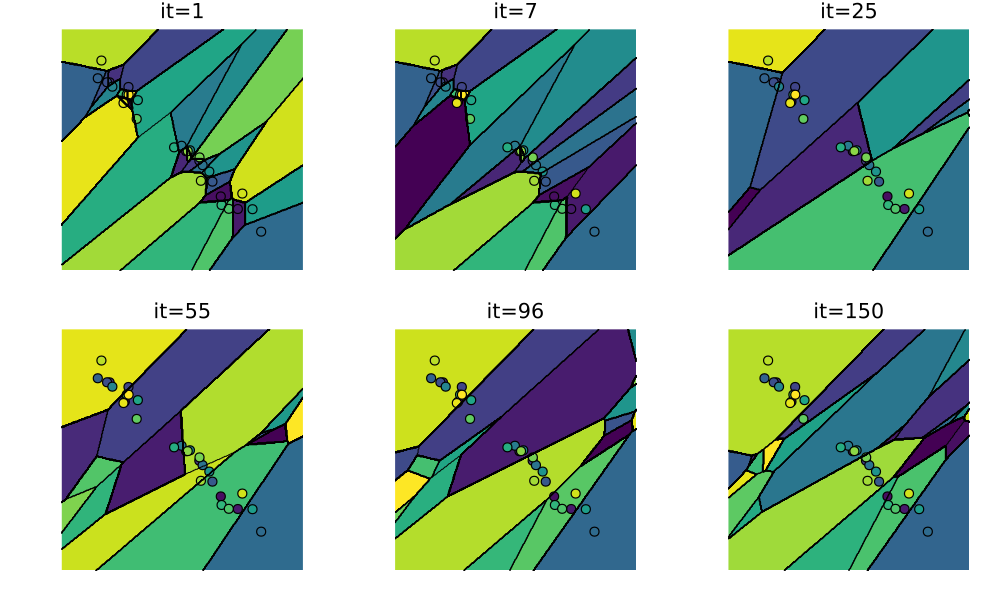

In [16]:
niter = 300
q = 6
ndisp = unique(round.(Int, 1 .+ (niter/2-1) .* LinRange(0, 1, q).^2))
kdisp = 1
E = zeros(niter)
f = zeros(n)

plt = plot(
    layout=(2, div(q,2)),
    size=(1000, 600),
    aspect_ratio=:equal,
    border=:none,
    xlims=(0,1),
    ylims=(0,1)
)

# assign color to source points
cmap = :viridis
x_color = get(cgrad(cmap), LinRange(0, 1, n))

for it in 1:niter
    # sample
    k = rand() < W[2] ? 2 : 1 # select one of the two Gaussian
    y = S .* randn(2) .+ [Mx[k], My[k]]

    # detect Laguerre cell where y is
    R = sum(y.^2) .+ sum(X.^2, dims=1) .- 2 .* y' * X - f'
    i = argmin(R)[2]

    # gradient
    nablaEy = copy(a)
    nablaEy[i] -= 1

    # gradient ascent
    l0 = 10  # warmup phase.
    tau = .1 / (1 + (it-1)/l0)
    f = f .+ tau .* nablaEy

    # compute Laguerre cells and c-transform
    D = distmat(Y, X) .- f'
    fC = minimum(D, dims=2)
    I = reshape(getindex.(argmin(D, dims=2), 2), (p, p))
    E[it] = sum(f .* a) + sum(fC .* vec(b))

    # display
    if (kdisp <= length(ndisp)) && (ndisp[kdisp] == it)
        heatmap!(plt[kdisp], t, t, I, aspect_ratio=:equal, colorbar=false, c=cmap)
        scatter!(plt[kdisp], X[2, :], X[1, :], markersize=5, color=x_color, label=nothing, axis=false)
        contour!(plt[kdisp], t, t, I, levels=range(0.5, n-0.5, n), color=:black)
        plot!(plt[kdisp], title="it=$it")
        kdisp += 1
    end
end

display(plt)

Display the evolution of the estimated OT distance (warning: recording this
takes lot of time).

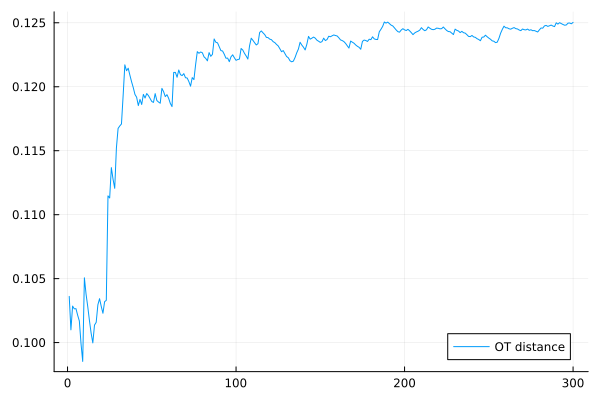

In [17]:
plot(E, label="OT distance")

Optimal Quantization and Lloyd Algorithm
----------------------------------------

We consider the following **optimal quantization problem** [Gruber02], where the goal is to approximate a continuous distribution $\beta$ by a discrete measure with optimally chosen weights and support points:
$$
\min_{(a_i)_i, \, (x_i)_i} W_c\left( \sum_i a_i \delta_{x_i}, \, \beta \right).
$$

The optimization is convex in the weights $a_i$, and writing down the optimality condition shows that the associated dual potentials are constant, i.e., $f = 0$. As a consequence, the optimal Laguerre cells reduce to standard Voronoi cells:
$$
V_i(x) := \left\{ y \in \mathcal{Y} \;\middle|\; \forall j, \; c(x_i, y) \leq c(x_j, y) \right\}.
$$
This connects the quantization problem to the semi-discrete optimal transport framework, as discussed in [Canas12].

The minimization becomes non-convex with respect to the positions $x = (x_i)_i$, and we aim to solve the following problem:
$$
\min_x \mathcal{F}(x) := \sum_{i=1}^n \int_{V_i(x)} c(x_i, y) \, \mathrm{d}\beta(y).
$$
To keep things simple, we consider the squared Euclidean cost:
$$
c(x, y) = \frac{1}{2} \|x - y\|^2.
$$

The gradient of the objective with respect to each $x_i$ is given by:
$$
\nabla \mathcal{F}(x)_i = x_i \int_{V_i(x)} \mathrm{d}\beta - \int_{V_i(x)} y \, \mathrm{d}\beta(y),
$$
which corresponds to the difference between the centroid and the barycenter of the mass captured by the Voronoi cell $V_i(x)$.

A widely used algorithm to compute stationary points of this energy is **Lloyd's algorithm** [Lloyd82], which performs the following fixed-point update:
$$
x_i \leftarrow \frac{ \int_{V_i(x)} y \, \mathrm{d}\beta(y) }{ \int_{V_i(x)} \mathrm{d}\beta }.
$$
In other words, each generator $x_i$ is updated to the barycenter of its Voronoi cell. This iterative process is simple yet powerful and underlies many practical applications such as vector quantization, $k$-means clustering, and coreset constructions for optimal transport.


Intialize the centroids positions.

In [18]:
X1 = copy(X);

Compute the Voronoi cells $V_i(x)$.

In [19]:
D = distmat(Y, X1)
fC = minimum(D, dims=2)
I = reshape(getindex.(argmin(D, dims=2), 2), (p, p));

Update the centroids to the barycenters.

In [20]:
A = [sum(b[I .== i]) for i in 1:n]
B = [sum((b .* (U .+ 1im*V))[I .== i]) for i in 1:n]
X1 = B ./ A
X1 = vcat(real.(X1)', imag.(X1)');

We implement **Lloyd's algorithm** to solve the optimal quantization problem. At each iteration, we:

- Compute the **Voronoi diagram** by assigning each grid point to its nearest center in `X1`.
- Evaluate the current **quantization energy** by summing the transport cost over the Voronoi cells.
- Update the generator positions by computing the **barycenter** of each cell with respect to the target density $\beta$.
- Display intermediate Voronoi diagrams at selected iterations (`ndisp`) to visualize convergence.

The algorithm runs for `niter = 60` steps, and generator positions are updated using complex coordinates for convenience.

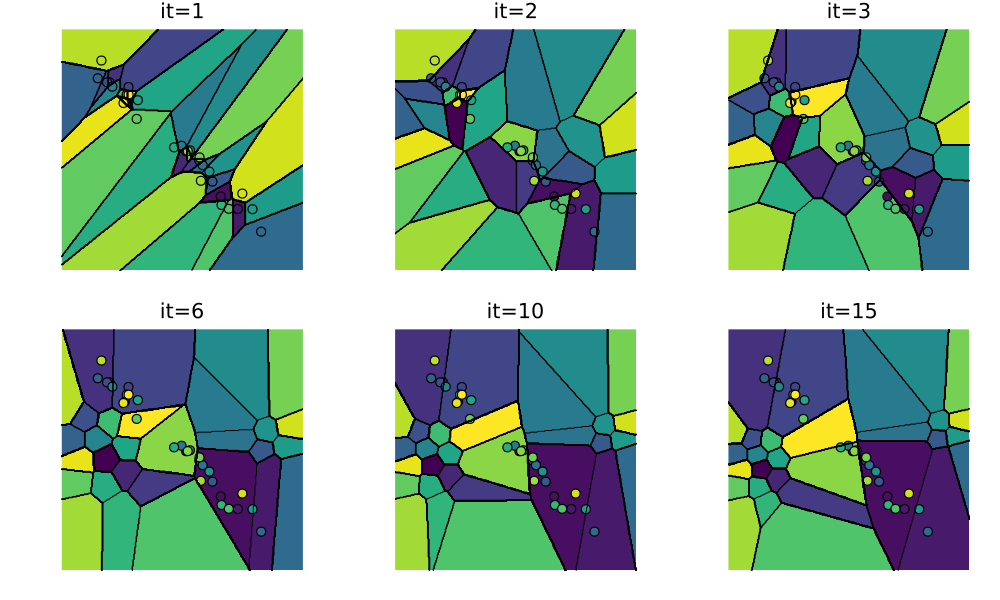

In [21]:
niter = 60
q = 6
ndisp = round.(Int, 1 .+ (niter/4-1) .* LinRange(0, 1, q).^2)
kdisp = 1
E = zeros(niter)
X1 = copy(X)

plt = plot(
    layout=(2, div(q,2)),
    size=(1000, 600),
    aspect_ratio=:equal,
    border=:none,
    xlims=(0,1),
    ylims=(0,1)
)

# assign color to source points
cmap = :viridis
x_color = get(cgrad(cmap), LinRange(0, 1, n))

for it in 1:niter
    # compute Voronoi cells
    D = distmat(Y, X1)
    fC = minimum(D, dims=2)
    I = reshape(getindex.(argmin(D, dims=2), 2), (p, p));
    E[it] = sum(fC .* vec(b))

    # display
    if (kdisp <= length(ndisp)) && (ndisp[kdisp] == it)
        heatmap!(plt[kdisp], t, t, I, aspect_ratio=:equal, colorbar=false, c=cmap)
        scatter!(plt[kdisp], X[2, :], X[1, :], markersize=5, color=x_color, label=nothing, axis=false)
        contour!(plt[kdisp], t, t, I, levels=range(0.5, n-0.5, n), color=:black)
        plot!(plt[kdisp], title="it=$it")
        kdisp += 1
    end

    # update barycenter
    A = [sum(b[I .== i]) for i in 1:n]
    B = [sum((b .* (U .+ 1im .* V))[I .== i]) for i in 1:n]
    X1 = B ./ A
    X1 = vcat(real.(X1)', imag.(X1)')
end

display(plt)

Display the evolution of the estimated OT distance.

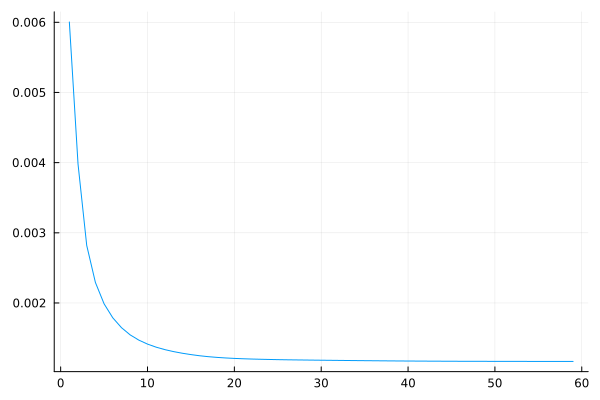

In [22]:
plot(E[2:end], label=nothing)


## References

- **[Oliker89]** Vladimir Oliker and Laird D. Prussner.  
  _On the numerical solution of the equation $\frac{\partial^2 z}{\partial x^2} \frac{\partial^2 z}{\partial y^2} - \left(\frac{\partial^2 z}{\partial x \partial y}\right)^2 = f$ and its discretizations_,  
  *Numerische Mathematik*, 54(3):271–293, 1989.

- **[Aurenhammer98]** Franz Aurenhammer, Friedrich Hoffmann, and Boris Aronov.  
  _Minkowski-type theorems and least-squares clustering_,  
  *Algorithmica*, 20(1):61–76, 1998.

- **[Mérigot11]** Quentin Mérigot.  
  _A multiscale approach to optimal transport_,  
  *Computer Graphics Forum*, 30(5):1583–1592, 2011.

- **[Lévy15]** Bruno Lévy.  
  _A numerical algorithm for L2 semi-discrete optimal transport in 3D_,  
  *ESAIM: Mathematical Modelling and Numerical Analysis*, 49(6):1693–1715, 2015.

- **[Aurenhammer87]** Franz Aurenhammer.  
  _Power diagrams: properties, algorithms and applications_,  
  *SIAM Journal on Computing*, 16(1):78–96, 1987.

- **[Canas12]** Guillermo Canas and Lorenzo Rosasco.  
  _Learning probability measures with respect to optimal transport metrics_,  
  In *Advances in Neural Information Processing Systems*, pages 2492–2500, 2012.

- **[Gruber02]** Peter M. Gruber.  
  _Optimum quantization and its applications_,  
  *Advances in Mathematics*, 186, 2004.

- **[Lloyd82]** Stuart P. Lloyd.  
  _Least squares quantization in PCM_,  
  *IEEE Transactions on Information Theory*, 28(2):129–137, 1982.

- **[Genevay16]** Aude Genevay, Marco Cuturi, Gabriel Peyré, and Francis Bach.  
  _Stochastic optimization for large-scale optimal transport_,  
  In *Advances in Neural Information Processing Systems*, pages 3440–3448, 2016.